# Sensationalism analysis

In [1]:
from email_utils import *
import pandas as pd
from sklearn.preprocessing import StandardScaler, MaxAbsScaler
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from pipeline_utils import *
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.calibration import CalibratedClassifierCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, f_classif
import eli5

pd.set_option('display.max_rows', 1500)

rc = {'axes.facecolor':'white',
      'axes.edgecolor': 'white',
      'axes.grid' : True,
      'grid.color': '.7',
      'font.family':'Helvetica',
      'font.size' : 20,
      'xtick.major.width': 0,
      'ytick.major.width': 0,
      'figure.dpi': 300}
plt.rcParams.update(rc)

2021-08-23 11:34:37 INFO: Writing properties to tmp file: corenlp_server-1fbd2bb952f34d8f.props


## Read the labeled dataset

Read in the labeled dataset.

In [2]:
df = pd.read_pickle('../data/learning/coded_df.pkl')
df_labels = pd.read_pickle('../data/learning/coded_labels.pkl')
label_column = 'sensationalism'

df = pd.concat([df, df_labels[label_column].reset_index(drop=True)], axis=1)

In [3]:
df[label_column].value_counts()

False    1658
True     1016
Name: sensationalism, dtype: int64

In [4]:
df.columns

Index(['name', 'subject', 'subject_decoded', 'from_name', 'from_address',
       'from_name_decoded', 'party_affiliation', 'source', 'office_level',
       'incumbent', 'input', 'input_decoded', 'input_decoded_ngram',
       'from_name_decoded_entities_replaced_lowercase',
       'from_name_decoded_entities_preserved_lowercase',
       'subject_decoded_entities_replaced_lowercase',
       'subject_decoded_entities_preserved_lowercase',
       'from_name_decoded_ngram_tags',
       'from_name_decoded_ngram_tags_stopwords', 'subject_decoded_ngram_tags',
       'subject_decoded_ngram_tags_stopwords', 'input_decoded_ngram_tags',
       'input_decoded_ngram_tags_stopwords',
       'from_name_decoded_ngram_tags_original',
       'from_name_decoded_ngram_tags_stopwords_original',
       'subject_decoded_ngram_tags_original',
       'subject_decoded_ngram_tags_stopwords_original',
       'input_decoded_ngram_tags_original',
       'input_decoded_ngram_tags_stopwords_original',
       'from_nam

In [5]:
len(df)

2674

## Split the data

Split the data into train and calibration sets.

In [6]:
labels = df[label_column]

In [7]:
xTrain, xVal, yTrain, yVal = train_test_split(df, labels, test_size=0.20, stratify=labels, random_state=random_state)

In [8]:
len(xTrain), len(yTrain)

(2139, 2139)

In [9]:
len(xVal), len(yVal)

(535, 535)

## Features

Feature pipeline

In [10]:
def get_feature_pipeline():
    return Pipeline([('features', FeatureUnion([
        ('ngram_tags', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_ngram_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('pos_tags', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_pos_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('dep_tags', Pipeline([
                ('column_selector', ColumnSelector(column='input_decoded_dep_tags')),
                ('features', TfidfVectorizer(tokenizer=lambda x: x, lowercase=False, use_idf=False, min_df=2)),
        ])),
        ('sentiment', Pipeline([
            ('features', DataSelector(column_list=['sentiment_input_neg',
                                                   'sentiment_input_neu',
                                                   'sentiment_input_pos']))
        ])),
        ('decoded_prop', Pipeline([
            ('features', DataSelector(column_list=['input_decoded_stop_words_prop',
                                                   'input_decoded_digits_prop',
                                                   'input_decoded_upper_prop',
                                                   'input_decoded_lower_prop']))
        ])),
        ('binary', Pipeline([
            ('features', DataSelector(column_list=['ends_punct',
                                                   'has_reference',
                                                   'content_word_present',
                                                   'question_or_follow_up_punct',
                                                   'has_quote',
                                                   'is_exclamation',
                                                   'is_question']))
        ])),
        ('counts', Pipeline([
            ('features', DataSelector(column_list=['cap_verb',
                                                   'cap_adj',
                                                   'cap_adv',
                                                   'cap_noun',
                                                   'subject_unicode_count',
                                                   'subject_raw_length',
                                                   'subject_decoded_word_count',
                                                   'from_name_unicode_count',
                                                   'from_name_raw_length',
                                                   'from_name_decoded_word_count', 
                                                   'punct_count',
                                                   'count_hyperbolic',
                                                   'count_common_sens',
                                                   'input_decoded_contraction_words_count',
                                                   'average_word_length'])),
            ('scale', MaxAbsScaler()),
        ])),
    ])),
                     ('select', SelectKBest(f_classif)),
                    ])

def get_feature_names(classifier):
    features = []
    for transformer in classifier.named_steps['feature_pipeline'].named_steps['features'].transformer_list:
        features.extend(transformer[1].named_steps['features'].get_feature_names())

    return features

## Support Vector Classifier

Randomized search using 5-fold cross validation

In [11]:
param_grid = {'classifier__C': [0.01, 0.1, 1.0, 10, 100],
              'classifier__kernel': ['rbf', 'linear'],
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__pos_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__dep_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}
          
svc_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                     ('classifier', svm.SVC(class_weight='balanced', probability=True, random_state=random_state))])

svc_clf = RandomizedSearchCV(svc_pipe, param_grid, n_jobs=-1, cv=5, n_iter=2000, verbose=5, scoring='f1', random_state=random_state)

svc_results = nested_cross_validation(svc_clf, xTrain, yTrain)

Fitting 5 folds for each of 2000 candidates, totalling 10000 fits


2021-08-23 11:35:44 INFO: Writing properties to tmp file: corenlp_server-3b35f1ffb25a48f3.props
2021-08-23 11:35:44 INFO: Writing properties to tmp file: corenlp_server-1707f4a0eaf74781.props
2021-08-23 11:35:44 INFO: Writing properties to tmp file: corenlp_server-ae7faf7558154eb7.props
2021-08-23 11:35:44 INFO: Writing properties to tmp file: corenlp_server-314bf93cd5944f0d.props
2021-08-23 11:35:44 INFO: Writing properties to tmp file: corenlp_server-ce2659f1a80f430b.props
2021-08-23 11:35:44 INFO: Writing properties to tmp file: corenlp_server-65af6d3729df44c7.props
2021-08-23 11:35:45 INFO: Writing properties to tmp file: corenlp_server-c9a9622315e441bc.props
2021-08-23 11:35:45 INFO: Writing properties to tmp file: corenlp_server-61a1e5eac05044b2.props
2021-08-23 11:35:45 INFO: Writing properties to tmp file: corenlp_server-d8ee7598668a467d.props
2021-08-23 11:35:45 INFO: Writing properties to tmp file: corenlp_server-a73e38e4a9ed46b3.props
2021-08-23 11:35:45 INFO: Writing proper

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.414 total time=   2.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   2.9s[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.658 total time=   2.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.633 total time=   2.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.347 total time=   2.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.621 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.620 total time=   2.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.417 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.614 total time=   2.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   3.9s[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.585 total time=   1.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.8s[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.7s[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.564 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.664 total time=   3.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   3.1s[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.569 total time=   2.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.648 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.404 total time=   1.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.588 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   4.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.516 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   3.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   4.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   2.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   4.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   3.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   3.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.544 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   3.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.685 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   3.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   2.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.699 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.592 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   3.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.673 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.452 total time=   2.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.604 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   3.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.548 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.478 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.563 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   3.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.446 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.505 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   3.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.623 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   3.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   3.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   3.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   2.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.602 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   3.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   3.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.636 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.476 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.585 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.603 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   3.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.555 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.605 total time=   2.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.811 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.577 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   3.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   2.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.683 total time=   2.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   3.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   2.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.443 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.802 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.461 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   2.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.684 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.571 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   3.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   5.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.592 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.552 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   3.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   3.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   1.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.672 total time=   2.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.675 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   3.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.423 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.477 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   2.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.613 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.655 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.610 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   3.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.570 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.636 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.492 total time=   2.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.597 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   2.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.616 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.604 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   3.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.605 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.621 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.539 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.585 total time=   1.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   3.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   3.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   2.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   4.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   3.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.655 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.799 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.593 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.570 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.601 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   3.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.636 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   4.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.637 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.562 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   3.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.614 total time=   2.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   2.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.654 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.490 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.643 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   2.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.458 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.592 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.604 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.622 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.327 total time=   2.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.620 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   1.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.642 total time=   2.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.678 total time=   2.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.570 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.648 total time=   2.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.277 total time=   2.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.620 total time=   2.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   1.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.594 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.646 total time=   2.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.547 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.796 total time=   1.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   1.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.308 total time=   1.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.636 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   2.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   3.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   2.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.594 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.486 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.637 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.577 total time=   2.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.616 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.495 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   2.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.627 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.487 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   2.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.503 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   2.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.802 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   2.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   2.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.606 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.651 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.574 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.503 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   2.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   2.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   3.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.565 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.422 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.691 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.607 total time=   2.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.552 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.600 total time=   2.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   2.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   1.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.562 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.680 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.587 total time=   2.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   4.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   4.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   3.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   1.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.518 total time=   2.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.584 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.633 total time=   2.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.680 total time=   2.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   2.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   2.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   2.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.695 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.553 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   2.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   2.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.486 total time=   2.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   4.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.661 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   4.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.560 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   5.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.547 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   2.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   2.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.669 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   4.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.472 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   1.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   2.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.642 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.423 total time=   2.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   3.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.645 total time=   2.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.560 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.624 total time=   2.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   3.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.495 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.585 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.555 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   4.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   3.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.422 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   3.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.534 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   2.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   3.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.555 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.601 total time=   2.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.643 total time=   2.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.327 total time=   2.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.664 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.593 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.607 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   2.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   3.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   3.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   2.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.578 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   4.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   2.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   3.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.626 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   2.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   2.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.437 total time=   2.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   4.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.356 total time=   2.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.531 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.607 total time=   1.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.593 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   2.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   4.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.363 total time=   2.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   2.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.680 total time=   3.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   3.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   3.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.672 total time=   3.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   2.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.505 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   2.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.574 total time=   2.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.464 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.571 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.386 total time=   1.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.567 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.366 total time=   2.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.585 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.607 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.538 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.619 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.452 total time=   1.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   2.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   3.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   4.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.409 total time=   1.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.321 total time=   2.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.624 total time=   2.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.639 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.620 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.327 total time=   2.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.570 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.495 total time=   2.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.552 total time=   2.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   2.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   3.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.374 total time=   2.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   2.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.634 total time=   2.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.552 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.402 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.608 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.193 total time=   3.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.551 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.555 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.593 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.620 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.675 total time=   4.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.256 total time=   3.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   2.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.3sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.297 total time=   2.0s
[CV 2/5] EN

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   4.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.549 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.678 total time=   3.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.551 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   2.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   3.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   1.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.594 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.567 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   2.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   2.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.664 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   2.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   2.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.559 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.553 total time=   1.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   3.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   2.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.576 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.698 total time=   2.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   3.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   2.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   2.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   4.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.565 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   2.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.574 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeli

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   3.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   3.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   2.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.586 total time=   2.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.541 total time=   2.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   2.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   3.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.801 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   2.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   2.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   3.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   4.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   4.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.633 total time=   2.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   3.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.575 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   2.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   2.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.423 total time=   3.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.860 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.588 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   3.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   1.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   1.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   1.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   2.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   3.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.664 total time=   3.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.614 total time=   2.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   4.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.629 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.354 total time=   3.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.659 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   2.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   3.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.638 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.675 total time=   3.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.580 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   3.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.567 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   2.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   2.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.641 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.846 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   2.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.624 total time=   2.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.523 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.632 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   3.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.594 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   3.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.814 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.824 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.623 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.664 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.580 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.590 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   3.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.639 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.645 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pi

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   2.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.537 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.348 total time=   2.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.640 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.456 total time=   2.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.554 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   2.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.462 total time=   2.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.551 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.848 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   3.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   3.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.425 total time=   2.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   2.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   3.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.647 total time=   2.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.811 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.790 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   2.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.663 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   3.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.650 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.655 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   2.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   2.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   3.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   2.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   3.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.613 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.705 total time=   4.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.818 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.652 total time=   1.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.655 total time=   1.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.848 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.704 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.632 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.411 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.834 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.578 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   2.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.640 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.565 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.637 total time=   2.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.581 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.563 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.574 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.624 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   3.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   2.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   3.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   3.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   3.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.655 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   3.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.658 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   2.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   2.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.601 total time=   2.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   2.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.670 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   3.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.857 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.641 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   2.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.625 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.638 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.371 total time=   3.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.592 total time=   2.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   2.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.673 total time=   2.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   4.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   2.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   2.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   4.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.610 total time=   2.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.667 total time=   2.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.412 total time=   3.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   2.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.855 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.841 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.682 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   2.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.684 total time=   1.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.620 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.593 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   5.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.599 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.801 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.601 total time=   2.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.500 total time=   2.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.588 total time=   2.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   3.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   3.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.598 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   2.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.661 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.593 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.652 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.561 total time=   1.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.519 total time=   2.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   2.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.673 total time=   2.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.534 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.648 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.603 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   2.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.699 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   3.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   3.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   2.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   3.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.500 total time=   2.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   1.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.664 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.661 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   3.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   3.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.633 total time=   3.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.656 total time=   2.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.645 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.604 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   2.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.604 total time=   1.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.581 total time=   2.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.541 total time=   2.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.850 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   3.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.623 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   2.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.573 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.526 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.654 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.630 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.639 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.707 total time=   3.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   2.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   2.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.627 total time=   2.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.574 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   4.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeli

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.678 total time=   2.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   2.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.364 total time=   3.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.642 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.682 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.616 total time=   3.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   2.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.571 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipel

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   2.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.645 total time=   2.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.597 total time=   2.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.602 total time=   2.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   2.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   3.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.549 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   2.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.649 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.420 total time=   3.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   4.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   4.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.518 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   2.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   4.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.844 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.622 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.592 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.546 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   3.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   2.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   2.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.611 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   4.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   3.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   3.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.581 total time=   2.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   4.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   2.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   3.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   2.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.535 total time=   2.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.690 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   3.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   4.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.463 total time=   2.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.650 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   3.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.456 total time=   2.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.597 total time=   2.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.673 total time=   2.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.446 total time=   2.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.503 total time=   2.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.588 total time=   2.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   2.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.425 total time=   2.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.654 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.607 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.438 total time=   2.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.610 total time=   1.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.624 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.633 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.600 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.838 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   3.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.646 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.684 total time=   4.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   2.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   2.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.639 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   3.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.664 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   4.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.503 total time=   2.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.655 total time=   2.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.652 total time=   1.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.592 total time=   2.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.682 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   3.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.577 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.664 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   3.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.590 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.437 total time=   3.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.664 total time=   3.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.610 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   2.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.844 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.623 total time=   2.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   4.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   3.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   3.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.620 total time=   2.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.581 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   4.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.571 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.495 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.584 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   3.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.581 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.553 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.686 total time=   3.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.609 total time=   2.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   3.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.574 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   3.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.610 total time=   1.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   2.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.449 total time=   3.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   2.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   2.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.610 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   4.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.436 total time=   1.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.356 total time=   2.2s
[CV 1/5] END clas

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   2.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   2.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.380 total time=   2.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   4.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   3.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.567 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.837 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   2.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   3.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   4.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.690 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.693 total time=   2.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.610 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.790 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   2.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.661 total time=   2.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.844 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   2.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.628 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   3.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.573 total time=   1.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.421 total time=   2.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   3.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.581 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   4.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.619 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   4.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   1.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.658 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   3.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.375 total time=   2.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   2.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.639 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   2.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   2.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   1.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.467 total time=   2.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   4.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.597 total time=   2.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   4.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.539 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.685 total time=   2.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.627 total time=   3.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.678 total time=   4.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.617 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.623 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.633 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   2.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   3.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.260 total time=   3.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.646 total time=   2.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.615 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   2.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.486 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.621 total time=   2.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   3.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.638 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   2.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.533 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.670 total time=   3.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.632 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.456 total time=   2.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   1.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.508 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   3.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.623 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   2.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.630 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   2.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.627 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.655 total time=   2.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   3.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   3.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   2.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   3.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.643 total time=   1.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.578 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.637 total time=   2.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   2.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   4.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   4.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.561 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.686 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.633 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   2.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   3.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   3.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.356 total time=   3.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.405 total time=   2.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.637 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   2.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   5.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   2.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.448 total time=   2.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   4.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.552 total time=   2.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.584 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.629 total time=   1.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   1.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   2.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   2.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.606 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.621 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   3.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.546 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.678 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.684 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.653 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   3.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   4.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.621 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   3.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   2.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.542 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.605 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   3.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   4.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   2.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   4.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   2.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.579 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.637 total time=   3.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.522 total time=   2.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.574 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.627 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.606 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.253 total time=   3.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   2.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   1.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.553 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.615 total time=   2.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.525 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.439 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.632 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   2.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   4.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   3.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.594 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.630 total time=   1.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.587 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.583 total time=   2.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   2.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.597 total time=   2.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   3.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.310 total time=   2.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   2.6s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   5.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   5.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   2.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.492 total time=   2.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.402 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.613 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.480 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__de

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.649 total time=   1.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.573 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.428 total time=   3.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.631 total time=   2.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   3.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.676 total time=   2.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.606 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.376 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.310 total time=   2.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   1.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   3.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.639 total time=   2.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.649 total time=   3.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   3.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.233 total time=   2.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.617 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.521 total time=   2.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   2.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   3.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.579 total time=   1.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   3.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.633 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.538 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.637 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   3.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.630 total time=   2.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.639 total time=   2.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.608 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   3.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.680 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   3.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.602 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   2.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.405 total time=   3.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   3.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   1.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.412 total time=   2.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.673 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   1.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.651 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.534 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.802 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.255 total time=   3.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.627 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.613 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.362 total time=   3.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   2.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.620 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.607 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   2.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.539 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.271 total time=   3.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   3.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.448 total time=   1.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   3.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   2.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   2.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__d

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   3.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   3.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   3.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   2.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   2.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.655 total time=   3.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.685 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   2.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   2.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.643 total time=   2.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   2.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   3.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   3.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.625 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   4.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   2.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   4.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   2.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   2.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.560 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.542 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   3.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   3.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.597 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.634 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   2.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.575 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   2.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   3.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.602 total time=   2.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   2.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.645 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.694 total time=   2.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   2.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__d

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.604 total time=   2.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.503 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.708 total time=   2.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.660 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   2.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.604 total time=   2.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.563 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.604 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   3.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.523 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   2.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.537 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.648 total time=   2.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   2.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   4.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.675 total time=   2.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   1.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.624 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.432 total time=   2.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.648 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   3.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   3.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.545 total time=   2.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.695 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.627 total time=   2.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   3.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.691 total time=   2.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.475 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.421 total time=   2.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.505 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.365 total time=   2.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.652 total time=   2.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.602 total time=   2.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.437 total time=   1.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   2.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   1.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.640 total time=   1.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.615 total time=   2.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.633 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.490 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   3.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.492 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   1.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.487 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.627 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.621 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.348 total time=   2.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   3.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeli

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 5/5] END classif

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   4.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   3.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.672 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   2.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   2.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.539 total time=   1.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.550 total time=   2.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   3.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   2.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.645 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   3.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   2.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.654 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   5.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.630 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.678 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.597 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.415 total time=   2.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.608 total time=   1.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.467 total time=   2.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.439 total time=   2.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   4.7s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   3.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   2.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   2.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.824 total time=   2.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   2.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   4.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.679 total time=   3.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   2.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.655 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   2.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.542 total time=   1.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.588 total time=   2.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   2.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.7s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   3.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   3.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.543 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   3.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   3.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   2.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipel

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   4.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   4.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   4.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.675 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   3.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.645 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.432 total time=   2.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.629 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.654 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.538 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.655 total time=   2.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.545 total time=   2.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   4.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   2.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   4.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.598 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.543 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   2.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   2.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.670 total time=   2.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.391 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   2.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   2.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.263 total time=   3.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.510 total time=   2.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.538 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   2.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.643 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   4.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.633 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.517 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   3.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.594 total time=   1.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.605 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.659 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   3.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   3.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.691 total time=   2.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   1.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.469 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.520 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.490 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   4.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   2.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.640 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.500 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   2.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.692 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.550 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.683 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.497 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.624 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   4.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.482 total time=   1.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   4.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.520 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.672 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.657 total time=   2.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.449 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   3.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   3.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.584 total time=   1.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   2.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   2.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.588 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.545 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.667 total time=   1.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   4.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.683 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   2.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   2.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.695 total time=   2.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.651 total time=   2.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.617 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.659 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   1.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.505 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.604 total time=   2.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   4.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.672 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.844 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.669 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.625 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.661 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   2.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.635 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.592 total time=   1.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   3.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   2.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.564 total time=   2.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipelin

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   2.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.661 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.675 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   2.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   2.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.493 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   3.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.454 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.675 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.638 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   3.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.646 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.497 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipelin

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.559 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   2.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.674 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   3.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   2.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   3.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.623 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.487 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   3.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   2.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.479 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.647 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.790 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.537 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.513 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipe

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   4.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   2.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.705 total time=   3.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.527 total time=   2.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.640 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.427 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.534 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.546 total time=   2.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   2.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   2.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   3.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.664 total time=   1.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   2.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.695 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.545 total time=   1.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.513 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.593 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.538 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeli

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.629 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.448 total time=   1.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   3.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.695 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.535 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.605 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   2.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.547 total time=   2.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.8s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.638 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.359 total time=   2.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   3.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.476 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.346 total time=   2.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   2.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   2.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.461 total time=   1.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.669 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   3.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.552 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.636 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.547 total time=   2.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   3.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   4.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.683 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   2.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   5.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.585 total time=   2.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.670 total time=   1.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.698 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   0.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.645 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   3.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.669 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   3.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features_

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.649 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.567 total time=   1.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   2.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.607 total time=   2.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.680 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   3.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.384 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.434 total time=   1.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   2.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.629 total time=   1.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   2.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   2.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.603 total time=   2.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   3.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.693 total time=   3.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   2.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.658 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.707 total time=   2.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.591 total time=   2.6s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.484 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.433 total time=   2.5s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   2.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   2.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.446 total time=   2.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.703 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   2.5s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.543 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.657 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   5.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.686 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   3.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__d

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.692 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   2.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.567 total time=   2.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.659 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.661 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.612 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.520 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.669 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   3.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.650 total time=   2.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.600 total time=   2.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   2.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   2.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.658 total time=   2.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   4.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.625 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   4.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.648 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   1.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.675 total time=   2.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.824 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.678 total time=   2.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.709 total time=   1.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   2.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   3.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.681 total time=   2.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.505 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_p

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.5s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.802 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   1.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.610 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.851 total time=   1.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.818 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.832 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.535 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   1.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.642 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.605 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.695 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.471 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   2.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.7s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.543 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.414 total time=   1.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.690 total time=   2.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.664 total time=   1.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   2.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.830 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.646 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   2.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.608 total time=   2.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   1.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.695 total time=   4.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.405 total time=   2.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.689 total time=   2.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   2.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   5.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   3.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   3.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.500 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.503 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   3.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   3.8s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.548 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   3.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.275 total time=   2.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.678 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   4.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.557 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   2.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.704 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.658 total time=   2.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.451 total time=   1.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.553 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.669 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.634 total time=   1.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.641 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.676 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.513 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   2.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.842 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.631 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.646 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pip

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.545 total time=   2.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.654 total time=   2.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.685 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   2.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.545 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   2.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.682 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.543 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   2.7s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.702 total time=   3.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   2.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.487 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   2.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   2.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   3.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.633 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.627 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   3.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.664 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   2.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.591 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.631 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.632 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.515 total time=   1.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.651 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.570 total time=   1.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.594 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.552 total time=   2.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   2.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.643 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   2.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.680 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.661 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   3.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.839 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.625 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.827 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.600 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.497 total time=   1.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.646 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.695 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.240 total time=   2.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.582 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.497 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   2.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.670 total time=   2.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipel

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   1.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.624 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.849 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.664 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   1.7s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.590 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   2.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   0.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   3.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   4.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   3.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   2.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.619 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.624 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.620 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.543 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   3.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.3s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.680 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.520 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipelin

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.575 total time=   2.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.7sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 4/5] END classifi

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   2.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__d

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.680 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__d

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.615 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   2.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.801 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.525 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   3.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.535 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.699 total time=   1.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.584 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.679 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.7s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.823 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.684 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.9s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   2.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   2.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.599 total time=   2.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.695 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.527 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.664 total time=   2.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   2.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.688 total time=   2.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.530 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.640 total time=   1.4s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeli

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.566 total time=   2.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.606 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.358 total time=   2.1s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.551 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.610 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_p

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   3.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   1.5s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipelin

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.695 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.818 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.571 total time=   1.7s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.582 total time=   1.5s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.8s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   3.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   3.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.670 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   3.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.612 total time=   1.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.465 total time=   2.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.548 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.593 total time=   2.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.841 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.582 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   2.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.651 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pip

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   3.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.574 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.818 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   3.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   3.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.622 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.565 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.520 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.503 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.565 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.657 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.608 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   3.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.584 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   2.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.825 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   3.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.348 total time=   2.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.601 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.637 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.543 total time=   3.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.639 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.552 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.510 total time=   1.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.549 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.596 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.513 total time=   2.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.595 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipel

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   2.8s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   2.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   2.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.565 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   2.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.533 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.703 total time=   2.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.552 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.579 total time=   1.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.638 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   2.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   2.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.828 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.819 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.833 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.420 total time=   2.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   4.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   2.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.601 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   1.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.589 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.855 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.425 total time=   3.2s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   2.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.622 total time=   1.6s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.631 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   2.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featur

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.589 total time=   1.5s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.594 total time=   1.7s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   3.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.565 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   3.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   2.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.667 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   3.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.645 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   3.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.637 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.589 total time=   1.9s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   4.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.664 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.565 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   2.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.689 total time=   1.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.525 total time=   2.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.669 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   3.8s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.573 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   3.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   1.7s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   3.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   2.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.825 total time=   2.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   2.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   3.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   3.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.618 total time=   1.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.839 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.653 total time=   0.7s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.590 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   4.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.617 total time=   2.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   1.6s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.832 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.615 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.508 total time=   2.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.571 total time=   1.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.425 total time=   2.2s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   3.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   4.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.798 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.826 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.8s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.603 total time=   1.6s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.9s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   4.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.583 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.596 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.601 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.838 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   1.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   3.1s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   3.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   2.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.608 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.612 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.612 total time=   2.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.645 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   4.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.835 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.367 total time=   3.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__d

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.645 total time=   1.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.635 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.571 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   4.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__de

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.585 total time=   2.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.802 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.843 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.695 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   2.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.615 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.637 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.576 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   0.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feature

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.609 total time=   2.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.628 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.579 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   2.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.546 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   3.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.695 total time=   1.3s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.8s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.635 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.610 total time=   2.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.833 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.5s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__d

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.669 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.610 total time=   2.6s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.448 total time=   2.7s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.532 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   2.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.535 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.547 total time=   2.5s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   1.4s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.821 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   2.0s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   3.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   1.6s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   2.0s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   4.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.690 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.595 total time=   2.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.644 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.594 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipelin

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.682 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   3.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipe

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.7s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.599 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.565 total time=   2.6s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.680 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   1.5s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.603 total time=   1.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.827 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   1.1s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.593 total time=   2.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   2.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.687 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__d

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   1.3s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   1.7s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.610 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   3.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.825 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline_

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   2.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   2.9s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.3s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   3.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.9s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.565 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.414 total time=   2.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   2.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   2.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   4.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featur

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   3.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   1.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   3.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   1.1s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.711 total time=   1.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.417 total time=   3.0s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   1.6s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   3.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.4s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.677 total time=   0.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.607 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   1.0s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.618 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.6s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__de

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   2.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.3s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__de

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.580 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.632 total time=   3.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__f

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   2.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   2.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   1.7s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__

[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   1.2s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.5s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.4s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   1.2s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.484 total time=   2.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.578 total time=   1.8s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   4.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.571 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   4.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   4.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   2.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   3.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   1.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   1.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   3.0s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   1.2s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.623 total time=   1.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   2.3s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   2.5s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.836 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.632 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.834 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__

[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__

[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.686 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   0.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   2.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline_

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.664 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   1.5s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__d

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   1.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   4.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.6s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fea

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   1.5s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.820 total time=   0.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.839 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.565 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.601 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   2.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.558 total time=   1.4s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   1.2s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.513 total time=   1.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featu

[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.5s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.685 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   1.6s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.618 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   1.7s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.9s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   4.6s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   3.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.831 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   2.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.612 total time=   2.5s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__f

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   2.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.586 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.548 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.831 total time=   0.9s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__feat

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   2.1s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   3.3s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   5.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.587 total time=   1.3s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.5s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   3.3s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   2.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.660 total time=   1.6s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   2.4s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feat

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.588 total time=   2.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   3.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   2.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   4.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   1.2s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   1.8s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   3.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__featur

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.596 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__featur

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.510 total time=   1.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   3.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   2.7s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.701 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.581 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.513 total time=   1.7s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.538 total time=   1.8s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.587 total time=   1.4s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   3.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.551 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.613 total time=   2.1s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipe

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.578 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.548 total time=   1.8s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.583 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipel

[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.635 total time=   3.0s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.675 total time=   1.2s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   4.2s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.607 total time=   2.3s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   2.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   1.4s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.615 total time=   2.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   5.4s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.8s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.575 total time=   3.0s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   3.4s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.616 total time=   1.6s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   2.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.657 total time=   1.5s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.575 total time=   2.3s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   1.3s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.4s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.2s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.576 total time=   1.4s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.603 total time=   2.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.4s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__feature

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   2.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   1.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline_

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.2s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.837 total time=   2.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.7s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.1s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.622 total time=   1.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.825 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.558 total time=   1.2s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline_

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   1.4s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.9s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   1.9s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.541 total time=   1.8s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.2s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   2.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   2.5s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   1.7s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   1.2s
[CV 4/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.9s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.618 total time=   2.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__fea

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.6s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   3.4s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.6s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   2.0s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   1.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__f

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.444 total time=   1.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   3.3s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   1.8s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.810 total time=   1.1s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   2.9s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__f

[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.6s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   1.6s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fe

[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.9s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.613 total time=   2.2s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__fea

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.503 total time=   2.6s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.8s
[CV 2/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   1.1s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   1.1s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.5s
[CV 1/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   2.9s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.584 total time=   1.9s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.433 total time=   2.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__de

[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.6s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.590 total time=   1.5s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.7s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features

[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.838 total time=   2.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.0s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   1.2s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline_

[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.425 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.7s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.575 total time=   1.8s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   2.8s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   1.4s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.435 total time=   3.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__feature

[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   1.4s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   4.5s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__featu

[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.537 total time=   2.4s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   1.1s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   1.1s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.686 total time=   1.5s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeli

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   1.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   1.3s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 4/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.9s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.551 total time=   1.6s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   1.0s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline

[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   2.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 4/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.587 total time=   1.4s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.511 total time=   2.0s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline_

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   2.1s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.642 total time=   1.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.6s
[CV 2/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__featu

[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.9s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.623 total time=   2.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.613 total time=   3.0s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipe

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   1.0s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.831 total time=   1.3s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.634 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipelin

[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   2.3s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   1.2s
[CV 3/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.7s
[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   2.1s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   1.3s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__

[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.8s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   2.0s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__f

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.740 total time=   3.5s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.7s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.7s
[CV 3/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__feat

[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   1.4s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features

[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   4.9s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   1.4s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.611 total time=   1.6s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__featu

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   2.5s
[CV 1/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.596 total time=   1.8s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__featur

[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   2.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.5s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   1.8s
[CV 5/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features_

[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 4/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.376 total time=   3.3s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   2.1s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__d

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   1.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   1.0s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   1.2s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__feature

[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.823 total time=   1.6s
[CV 2/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.840 total time=   2.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 2/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__fea

[CV 3/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   1.6s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.831 total time=   1.2s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features_

In [12]:
for i, sr in enumerate(svc_results):
    print('Fold ', i)
    print('F1 score ', sr[0])
    print('Params ', sr[2])
    print('\n')

Fold  0
F1 score  0.8125000000000001
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 1.0, 'feature_pipeline__features__ngram_tags__features__max_df': 0.1, 'feature_pipeline__features__dep_tags__features__max_df': 1.0, 'classifier__kernel': 'linear', 'classifier__C': 1.0}


Fold  1
F1 score  0.782608695652174
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.01, 'feature_pipeline__features__ngram_tags__features__max_df': 0.04, 'feature_pipeline__features__dep_tags__features__max_df': 1.0, 'classifier__kernel': 'linear', 'classifier__C': 1.0}


Fold  2
F1 score  0.7668711656441718
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 1.0, 'feature_pipeline__features__ngram_tags__features__max_df': 1.0, 'feature_pipeline__features__dep_tags__features__max_df': 1.0, 'classifier__kernel': 'rbf', 'classifier__C': 10}


Fold  3
F1 score

In [13]:
np.mean(list(map(lambda x: x[0], svc_results)))

0.775243595973135

In [14]:
features_all = get_feature_names(svc_results[0][1])
features_mask = svc_results[0][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_svc = [b for a, b in zip(features_mask, features_all) if a]

In [15]:
eli5.explain_weights(svc_results[0][1].named_steps['classifier'], top=100, feature_names=features_svc)

Weight?,Feature
+2.414,urgent
+2.217,count_common_sens
+2.216,tokenperson celebrate
+2.046,regret
+2.003,input_decoded_upper_prop
+1.767,alert
+1.761,cap_verb
+1.745,cap_noun
+1.658,news
+1.568,notice


## Random forest

Randomized search using 5-fold cross validation

In [16]:
n_estimators = [10, 50, 100, 200, 500]
max_depth = [10, 30, 50, 100]
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [2, 5, 10]
criterion = ['gini', 'entropy']

param_grid = {'classifier__n_estimators': n_estimators,
              'classifier__max_depth': max_depth,
              'classifier__min_samples_split': min_samples_split,
              'classifier__min_samples_leaf': min_samples_leaf,
              'classifier__criterion': criterion,
              'feature_pipeline__select__k': [500],
              'feature_pipeline__features__ngram_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__pos_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0],
              'feature_pipeline__features__dep_tags__features__max_df': [0.005, 0.01, 0.02, 0.04, 0.1, 1.0]}

rf_pipe = Pipeline([('feature_pipeline', get_feature_pipeline()),
                    ('classifier', RandomForestClassifier(class_weight='balanced', random_state=random_state))])

rf_clf = RandomizedSearchCV(rf_pipe, param_grid, n_jobs=-1, cv=5, n_iter=2000, verbose=5, scoring='f1', random_state=random_state)
rf_results = nested_cross_validation(rf_clf, xTrain, yTrain)

Fitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.1s
[CV 2/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 4/5] END

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.686 total time=   2.0s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.8s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   4.0s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features_

[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.7s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 4/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   1.1s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   2.1s
[CV 4/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   1.7s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.1s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.677 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.823 total time=   2.2s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.817 total time=   2.0s
[CV 3/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__

[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   1.1s
[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   4.8s
[CV 5/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 1/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__fea

[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   2.5s
[CV 3/5] END classifier__C=0.01, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.551 total time=   1.4s
[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__fe

[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.398 total time=   2.5s
[CV 2/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   1.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.6s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fea

[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.596 total time=   2.3s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.801 total time=   1.5s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.3s
[CV 3/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__fe

[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   2.2s
[CV 5/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   1.2s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.3s
[CV 5/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__feat

[CV 3/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 2/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__feature

[CV 4/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   2.4s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   1.6s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 1/5] END classifier__C=0.1, classifier__kernel=linear, feature_pipeline__

[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.6s
[CV 4/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   2.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.2s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   2.8s
[CV 5/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, sc

[CV 4/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   2.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   1.3s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   3.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 5/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.630 total time=   1.3s
[CV 5/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, scor

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 5/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   2.9s
[CV 1/5] END classifier__C=1.0, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 1/5] END classifier__C=0.1, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   3.0s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, sc

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 3/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 1/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   2.3s
[CV 5/5] END classifier__C=100, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 2/5] END classifier__C=0.01, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   1.0s
[CV 1/5] END classifier__C=10, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   1.0s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, 

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 4/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.5s
[CV 2/5] END classifier__C=100, classifier__kernel=linear, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.7

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   1.9s
[CV 2/5] END classifier__C=10, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 3/5] END classifier__C=1.0, classifier__kernel=rbf, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.7

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   2.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   3.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   2.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   3.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   3.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   2.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   2.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   2.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   2.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   2.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   2.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.674 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   2.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   2.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.699 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50,

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.654 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   2.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   2.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   2.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   3.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   2.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   2.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   1.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   2.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   3.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.695 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   3.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   2.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   2.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   2.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   2.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.644 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   2.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   3.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   2.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, f

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.594 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   2.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   2.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   2.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   2.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.796 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   2.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   1.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   2.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   2.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.640 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   3.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   2.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   3.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   2.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   2.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.692 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   3.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   2.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, 

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   2.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.695 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   2.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   2.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   2.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, f

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   2.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   2.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   3.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   2.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   2.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   3.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.802 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.672 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, f

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   3.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   2.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   2.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   2.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, f

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   3.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   3.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.687 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.802 total time=   3.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100,

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   2.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   3.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   1.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   1.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   2.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   2.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   3.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.640 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   2.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.681 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.653 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   3.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   2.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   2.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.1sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, cl

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.694 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   2.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.659 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   2.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   2.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   2.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   3.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   2.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.697 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   2.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.798 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.821 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   2.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   2.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.651 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   2.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   2.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   3.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.812 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.790 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, 

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   3.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   2.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   2.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   2.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.779 total time=   1.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   2.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   2.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   2.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.793 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   2.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.807 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   2.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.647 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   2.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   2.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.662 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.652 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   2.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.681 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.804 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   3.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.659 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.683 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   3.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.801 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.821 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.793 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   2.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.793 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   2.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.821 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.796 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   2.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   2.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.831 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   3.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.739 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   2.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.745 total time=   2.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   3.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   2.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.790 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   2.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.720 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, f

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.829 total time=   3.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.685 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   2.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200,

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.641 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.819 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.812 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.741 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.699 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   3.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   2.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   2.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.705 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   2.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   1.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   2.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   2.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   2.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.801 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   2.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.807 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.801 total time=   2.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   2.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   2.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   3.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.812 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.796 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.790 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.803 total time=   3.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.796 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.817 total time=   2.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   1.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.799 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.793 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   3.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.619 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.723 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.703 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, f

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.695 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.717 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.796 total time=   1.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   2.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   2.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   2.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.699 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   2.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.810 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.697 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   2.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.692 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   2.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   3.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.828 total time=   2.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.804 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   2.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.830 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.669 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   2.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.799 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.685 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.813 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.808 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.809 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   2.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.7sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, cl

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.710 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   1.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   2.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   2.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   2.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.812 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   3.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   3.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   3.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   2.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   3.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   2.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.684 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   3.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.725 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500,

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, f

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   3.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.683 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, 

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.678 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   2.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   3.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   3.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   2.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   2.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.767 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   3.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.739 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   3.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   1.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   2.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.683 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   2.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.820 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   3.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.752 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   2.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.805 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipelin

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   3.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, 

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.672 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.651 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   2.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   2.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.684 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   1.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   3.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.778 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   2.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   3.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.790 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.664 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   3.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   2.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   3.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   2.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.713 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, f

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50,

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.814 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.661 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   3.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.685 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   2.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.695 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.667 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.808 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.791 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.756 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.726 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.635 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   2.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.768 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   2.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   3.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.695 total time=   2.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.695 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.669 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   1.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.709 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   2.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, 

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   2.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, f

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.753 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.694 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   2.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   2.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.707 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   3.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.644 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   1.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.643 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   2.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   2.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   2.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.812 total time=   2.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.713 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.750 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.675 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   3.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   3.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.685 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.789 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.752 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.683 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, 

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   2.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200,

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   2.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   2.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   2.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.689 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   2.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   2.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   1.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   2.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   2.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.771 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.757 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   2.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.728 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   2.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.651 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   3.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.795 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   2.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, 

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.734 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200,

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   2.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.695 total time=   0.2sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, cla

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   2.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.761 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.736 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   2.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.690 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   3.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   3.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.638 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.733 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.700 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.800 total time=   3.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   3.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   2.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.701 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.749 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, 

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.714 total time=   2.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.807 total time=   3.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   1.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   2.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   1.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.657 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.801 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200,

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.771 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.700 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.680 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.701 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.696 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.703 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.730 total time=   3.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.706 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   2.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.674 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   2.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   2.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.685 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.809 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   2.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.705 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.661 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   2.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.768 total time=   1.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.704 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   2.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.793 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.669 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   3.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   2.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.688 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   2.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.695 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.642 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.683 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, 

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.650 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.746 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.740 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.800 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   2.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   3.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   3.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   3.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   2.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   1.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   3.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.648 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.757 total time=   2.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.795 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   2.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.691 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.725 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.765 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.697 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.678 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   3.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.802 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   2.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.795 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.820 total time=   1.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   2.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.748 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.774 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.775 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   2.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   3.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipelin

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.675 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   2.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   3.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   2.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.664 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   3.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.792 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.746 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.801 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   3.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   2.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   4.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   1.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.692 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.662 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.652 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   2.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.662 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   3.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, f

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   2.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   2.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.808 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   3.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   3.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.667 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.798 total time=   2.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   3.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.721 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.789 total time=   3.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.794 total time=   3.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.674 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.698 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   3.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.699 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.785 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   1.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   2.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   2.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.650 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.742 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.771 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.751 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.798 total time=   1.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.781 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.812 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.817 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.712 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.659 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.721 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.693 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.805 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   2.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   3.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipelin

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.694 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   3.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   1.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.632 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.814 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.664 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200,

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.822 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   3.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   2.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.714 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.801 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.764 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   1.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.661 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   3.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   2.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipelin

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.717 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.664 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.711 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   2.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   2.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.802 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   2.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.792 total time=   1.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, f

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.682 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   2.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.727 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.710 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.651 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipelin

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   2.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   2.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   2.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   2.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.805 total time=   1.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.727 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.802 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   2.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipelin

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   3.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   2.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.746 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   3.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.703 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.685 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   3.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   4.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.715 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200,

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   2.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.706 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.664 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.720 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   2.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   4.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipelin

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   1.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   3.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.691 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   1.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   1.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.699 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.702 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.680 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.770 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.732 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.701 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.795 total time=   2.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.674 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.786 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.771 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.753 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.664 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.756 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.791 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   3.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.721 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   3.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   3.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.792 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.771 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.802 total time=   3.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   2.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, fe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.735 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.715 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   2.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.718 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.713 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.711 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.803 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.710 total time=   2.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   1.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.780 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.808 total time=   3.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.656 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   2.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.702 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.815 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.694 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.747 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.805 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.798 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.788 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.705 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   0.7sFitting 5 folds for each of 2000 candidates, totalling 10000 fits

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, class

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.749 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.708 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.768 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.758 total time=   1.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.795 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   2.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.669 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   2.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.787 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.763 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.709 total time=   2.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   2.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.739 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.766 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipelin

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   2.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   3.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   3.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.729 total time=   2.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   2.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.716 total time=   2.0s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   2.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.720 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.715 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.779 total time=   3.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.766 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.802 total time=   2.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.815 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.773 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.745 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.765 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.832 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.784 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   2.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.828 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50,

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.800 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.741 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.749 total time=   2.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.740 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.775 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   2.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.726 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   3.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   1.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   2.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   1.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.781 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.815 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.701 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.826 total time=   3.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.826 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipelin

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   2.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.708 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.702 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, f

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   2.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   1.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   1.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.654 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.788 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   2.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.786 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   3.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeli

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   3.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   1.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.709 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.788 total time=   3.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   2.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.839 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.768 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.758 total time=   1.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   1.0s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.723 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   2.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.732 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.775 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.783 total time=   2.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.724 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.819 total time=   2.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   2.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.682 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fe

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.664 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.801 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.794 total time=   2.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.744 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.696 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.804 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.772 total time=   2.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.814 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.681 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.783 total time=   2.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.851 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10,

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.667 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.781 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, fea

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.807 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeli

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.736 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.705 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.745 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.707 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.781 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.744 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.723 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.842 total time=   2.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   1.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.776 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.664 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.708 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.827 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.843 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   1.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   1.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.813 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.819 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.688 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.732 total time=   1.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   2.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.691 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.802 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.820 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   2.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.804 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.809 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.767 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   2.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.818 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.711 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   3.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.780 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.731 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipel

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.728 total time=   2.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.713 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.804 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.732 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.833 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.709 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.696 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.813 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.806 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.819 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.775 total time=   0.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.721 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.700 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.649 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   2.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, f

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipel

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.816 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   1.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.750 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   1.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.822 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.787 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.744 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.700 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.740 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.757 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.809 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, fe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.686 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.724 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.782 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.751 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.682 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, f

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.689 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.815 total time=   0.8s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.778 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.728 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   1.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.761 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.762 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.754 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.794 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.726 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.680 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.767 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.776 total time=   1.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.9s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.784 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.722 total time=   1.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.791 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.816 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.789 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   1.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.750 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.799 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.769 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   0.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.811 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feat

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.777 total time=   1.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.778 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.823 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   1.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.697 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.778 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.9s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.714 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.823 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.803 total time=   1.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.790 total time=   3.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.836 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.714 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipelin

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.785 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   1.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.722 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   3.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.840 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.820 total time=   1.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.787 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.785 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipel

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.837 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   0.8s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.715 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.837 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.647 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.763 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.754 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.772 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.782 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.729 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.734 total time=   1.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.701 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.814 total time=   3.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.794 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.786 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.753 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.754 total time=   3.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.693 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.824 total time=   2.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   2.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.782 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.716 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.815 total time=   2.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.806 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.790 total time=   0.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   1.0s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.758 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   2.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.728 total time=   1.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.835 total time=   2.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.724 total time=   1.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.677 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   2.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.780 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   1.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.791 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.796 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.674 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.724 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.787 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500,

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.788 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.640 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.576 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.733 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.836 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.737 total time=   1.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   1.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   2.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.783 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.845 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=1

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.714 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.732 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.748 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.779 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.712 total time=   2.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.798 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.797 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipelin

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.781 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.706 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.762 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.763 total time=   2.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.800 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, 

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.722 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   2.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.765 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, f

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.714 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.728 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.761 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.760 total time=   2.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.707 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.717 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.707 total time=   1.8s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   1.8s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.697 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   0.4s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.729 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   1.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.804 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.750 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   2.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.765 total time=   1.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, fe

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.777 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.747 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.780 total time=   2.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.768 total time=   0.6s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.738 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.792 total time=   0.4s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.785 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.760 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.702 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.742 total time=   0.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.838 total time=   0.5s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.687 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.735 total time=   0.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.729 total time=   2.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.762 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.758 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   1.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.758 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.763 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.813 total time=   2.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.782 total time=   1.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, featu

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.818 total time=   2.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.746 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.773 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.768 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipe

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.672 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.792 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.798 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.659 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.807 total time=   2.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.702 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.725 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, fe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.758 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.804 total time=   1.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.730 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.821 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.735 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   1.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.816 total time=   1.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeli

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.770 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.764 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.793 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.776 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.732 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.718 total time=   0.7s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.743 total time=   1.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.753 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.736 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   1.0s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.809 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, 

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.761 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipe

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   1.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.725 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.742 total time=   2.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.811 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.748 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.738 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.767 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.793 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   2.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.708 total time=   2.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.704 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   1.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.770 total time=   1.0s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.825 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   1.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.756 total time=   2.0s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.760 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.733 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.826 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.779 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.736 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.747 total time=   2.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.716 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.806 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.772 total time=   2.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.810 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.745 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.719 total time=   1.8s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.717 total time=   0.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.813 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.777 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.755 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, featur

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.748 total time=   1.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.801 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.7s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.771 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.786 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.747 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.719 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.797 total time=   1.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.794 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feat

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   0.5s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.719 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, fe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.752 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.806 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.718 total time=   1.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.764 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.726 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.717 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.827 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_p

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.730 total time=   2.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.749 total time=   2.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.797 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.717 total time=   0.9s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.761 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.764 total time=   0.6s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, featu

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.707 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   0.3s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.769 total time=   0.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.807 total time=   0.3s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.797 total time=   0.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, featu

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.716 total time=   2.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.751 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.810 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.713 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.796 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.739 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.766 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.725 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeli

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.777 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.727 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.2s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_p

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.808 total time=   2.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipe

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.766 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.706 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, featu

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.709 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.764 total time=   0.3s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, featu

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.745 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.744 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.741 total time=   1.9s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.706 total time=   2.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_p

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.712 total time=   1.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.755 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.756 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.710 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.745 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.751 total time=   0.9s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.773 total time=   0.7s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.783 total time=   2.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.789 total time=   0.6s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipel

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.800 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.747 total time=   0.5s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.789 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipelin

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.722 total time=   0.7s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.9s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, fe

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.724 total time=   2.0s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.708 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, featur

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.712 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.764 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pip

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.777 total time=   2.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.810 total time=   0.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.704 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.726 total time=   0.7s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.731 total time=   0.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.803 total time=   1.7s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.737 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.737 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_p

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.703 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.797 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, featur

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.713 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.728 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.702 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, f

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.721 total time=   1.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.774 total time=   0.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, fe

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.824 total time=   1.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.720 total time=   1.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feat

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.721 total time=   1.9s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.826 total time=   0.9s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pip

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.759 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.644 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.769 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.752 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.729 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.790 total time=   0.5s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.757 total time=   1.4s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.756 total time=   0.6s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.742 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, featur

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.817 total time=   2.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   0.3s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.734 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.741 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_p

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.799 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.774 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pi

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.677 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.831 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=500, fea

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.792 total time=   2.7s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   0.4s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.822 total time=   2.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.754 total time=   0.4s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pip

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.751 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.709 total time=   0.6s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.730 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=100, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.726 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.730 total time=   0.4s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pip

[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.770 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.833 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature

[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.775 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.791 total time=   0.5s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pi

[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.785 total time=   1.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.741 total time=   0.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.827 total time=   1.0s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, featur

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.711 total time=   0.5s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.759 total time=   2.3s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feat

[CV 2/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.809 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.743 total time=   0.4s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feat

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.733 total time=   0.8s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.752 total time=   0.5s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, featur

[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.766 total time=   1.9s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.705 total time=   0.5s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, fea

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.757 total time=   0.4s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.803 total time=   1.0s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.794 total time=   0.1s
[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.744 total time=   0.1s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.752 total time=   1.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.756 total time=   2.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feat

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.787 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.816 total time=   2.8s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_p

[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.729 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.6s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=10, featur

[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.724 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.664 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=50, fea

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.754 total time=   0.1s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   1.2s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=200, feature_

[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.718 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.778 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeli

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.699 total time=   0.2s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.761 total time=   0.3s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.733 total time=   0.2s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.731 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeli

[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.750 total time=   0.4s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.784 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipel

In [17]:
for i, rr in enumerate(rf_results):
    print('Fold ', i)
    print('F1 score ', rr[0])
    print('Params ', rr[2])
    print('\n')

Fold  0
F1 score  0.8401253918495297
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.04, 'feature_pipeline__features__ngram_tags__features__max_df': 0.1, 'feature_pipeline__features__dep_tags__features__max_df': 0.04, 'classifier__n_estimators': 500, 'classifier__min_samples_split': 5, 'classifier__min_samples_leaf': 2, 'classifier__max_depth': None, 'classifier__criterion': 'entropy'}


Fold  1
F1 score  0.7801857585139318
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__features__pos_tags__features__max_df': 0.04, 'feature_pipeline__features__ngram_tags__features__max_df': 0.04, 'feature_pipeline__features__dep_tags__features__max_df': 0.04, 'classifier__n_estimators': 50, 'classifier__min_samples_split': 5, 'classifier__min_samples_leaf': 2, 'classifier__max_depth': 100, 'classifier__criterion': 'entropy'}


Fold  2
F1 score  0.8023952095808383
Params  {'feature_pipeline__select__k': 500, 'feature_pipeline__feat

In [18]:
np.mean(list(map(lambda x: x[0], rf_results)))

0.7827983525988819

In [19]:
features_all = get_feature_names(rf_results[0][1])
features_mask = rf_results[0][1].named_steps['feature_pipeline'].named_steps['select'].get_support()
features_rf = [b for a, b in zip(features_mask, features_all) if a]

In [20]:
eli5.explain_weights(rf_results[0][1].named_steps['classifier'], top=100, feature_names=features_rf)

Weight,Feature
0.1137 ± 0.1338,sentiment_input_neg
0.0955 ± 0.1564,input_decoded_upper_prop
0.0757 ± 0.1001,sentiment_input_pos
0.0398 ± 0.0440,sentiment_input_neu
0.0363 ± 0.0853,cap_verb
0.0338 ± 0.0353,subject_raw_length
0.0315 ± 0.0505,punct_count
0.0308 ± 0.0662,cap_noun
0.0296 ± 0.0396,from_name_raw_length
0.0282 ± 0.0416,count_common_sens


## Compute the final performance on the holdout set

In [21]:
rf_results[0][2]

{'feature_pipeline__select__k': 500,
 'feature_pipeline__features__pos_tags__features__max_df': 0.04,
 'feature_pipeline__features__ngram_tags__features__max_df': 0.1,
 'feature_pipeline__features__dep_tags__features__max_df': 0.04,
 'classifier__n_estimators': 500,
 'classifier__min_samples_split': 5,
 'classifier__min_samples_leaf': 2,
 'classifier__max_depth': None,
 'classifier__criterion': 'entropy'}

In [22]:
clf = Pipeline([('feature_pipeline', get_feature_pipeline()),
                ('classifier', RandomForestClassifier(class_weight='balanced', random_state=random_state))])

clf.set_params(**rf_results[0][2])
clf.fit(xTrain, yTrain)

Pipeline(steps=[('feature_pipeline',
                 Pipeline(steps=[('features',
                                  FeatureUnion(transformer_list=[('ngram_tags',
                                                                  Pipeline(steps=[('column_selector',
                                                                                   ColumnSelector(column='input_decoded_ngram_tags')),
                                                                                  ('features',
                                                                                   TfidfVectorizer(lowercase=False,
                                                                                                   max_df=0.1,
                                                                                                   min_df=2,
                                                                                                   tokenizer=<function get_feature_pipeline.<locals>.<lambda> at 0x7fad75

In [24]:
holdout = pd.read_pickle('../data/learning/holdout_df.pkl')
holdout_labels  = pd.read_pickle('../data/learning/holdout_labels.pkl')

holdout = pd.concat([holdout, holdout_labels[label_column].reset_index(drop=True)], axis=1)

Test set output:
1. Classification report:
              precision    recall  f1-score   support

       False       0.87      0.88      0.88       300
        True       0.82      0.81      0.81       200

    accuracy                           0.85       500
   macro avg       0.85      0.84      0.85       500
weighted avg       0.85      0.85      0.85       500



2. Confusion matrix:
     pred_neg  pred_pos
neg       265        35
pos        39       161


4. False positives:
                                            name  \
24                                 Tea Party PAC   
28                 Democratic National Committee   
35                                   Manny Sethi   
36                          Sri Preston Kulkarni   
65                                 Evelyn Farkas   
72                                   Beth Doglio   
88      Democratic Attorneys General Association   
118                                    Kim Olson   
150                              Barbara Boll

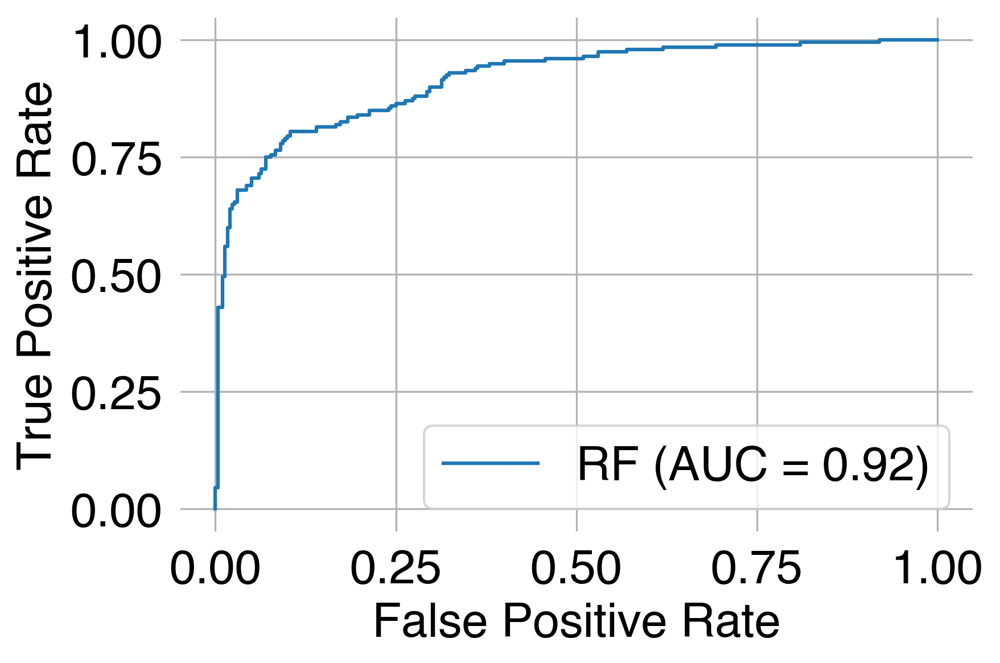

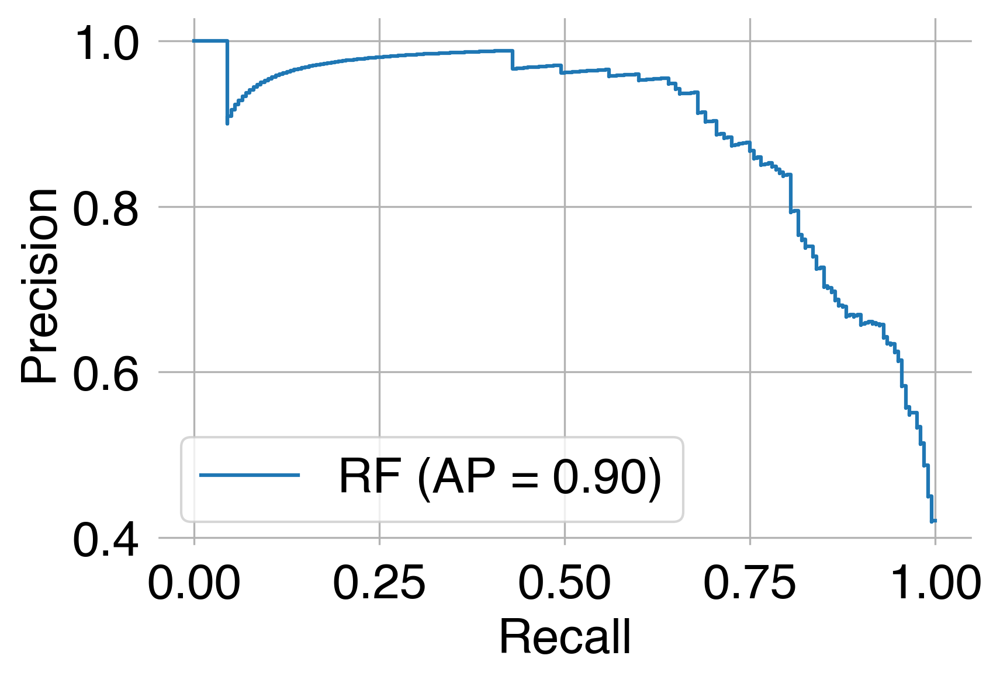

In [42]:
print_classifier_output(clf, holdout, holdout[label_column], actual_subjects=holdout, classifier_name='RF', filepath='../data/plots/sensationalism_')

## Calibration test

  category      prop      mean        ll        ul  count
0        1  0.028846  0.140989  0.015560  0.032648  208.0
1        2  0.220339  0.379027  0.065304  0.082939  118.0
2        3  0.715447  0.619502  0.085317  0.072267  123.0
3        4  0.965116  0.852979  0.062725  0.022950   86.0


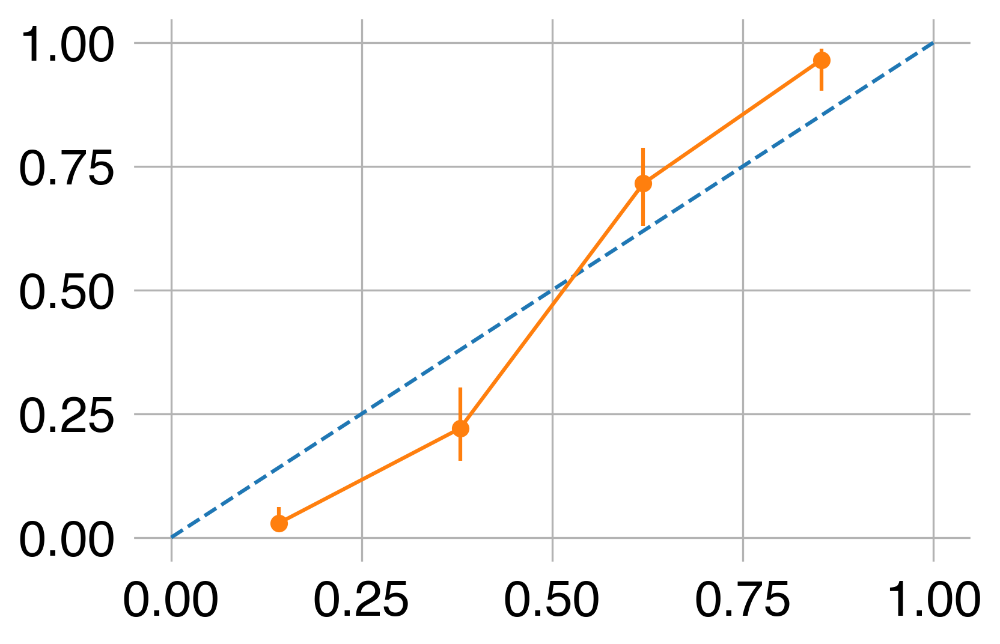

  category                 group      prop      mean        ll        ul  \
0        1  ballotpedia-campaign  0.006369  0.138175  0.005244  0.028823   
1        1                  orgs  0.098039  0.149650  0.055431  0.111743   
2        2  ballotpedia-campaign  0.225000  0.382677  0.077668  0.102868   
3        2                  orgs  0.210526  0.371343  0.099778  0.152931   
4        3  ballotpedia-campaign  0.686567  0.614845  0.118613  0.098379   
5        3                  orgs  0.750000  0.625073  0.126926  0.094829   
6        4  ballotpedia-campaign  0.975000  0.851975  0.103814  0.020573   
7        4                  orgs  0.956522  0.853853  0.101844  0.031473   

   count  
0  157.0  
1   51.0  
2   80.0  
3   38.0  
4   67.0  
5   56.0  
6   40.0  
7   46.0  
Brier score loss: 0.10949168421830124


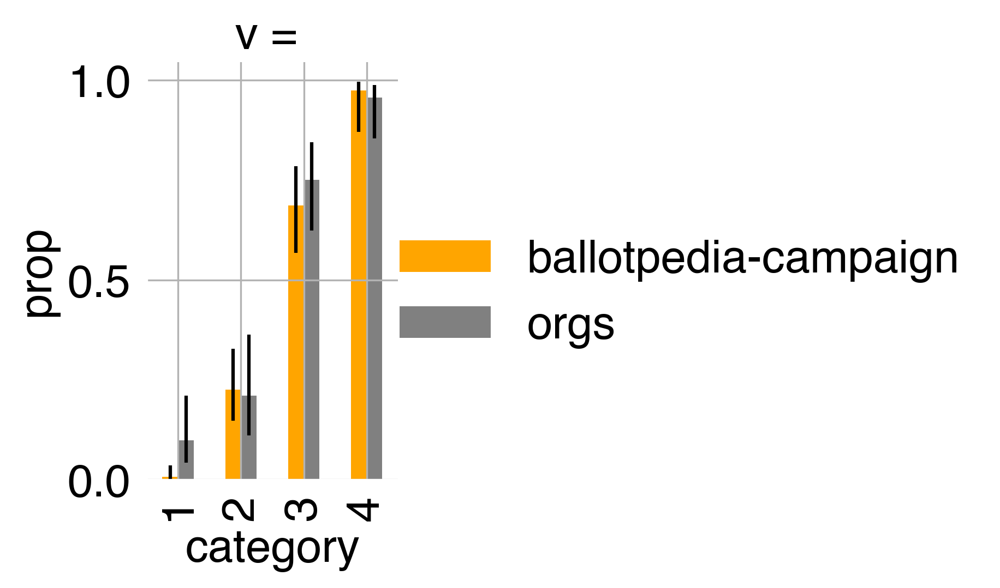

In [27]:
print_calibration_output(clf, xVal, yVal, groups=xVal['source'], bins=4)

In [28]:
featVal = clf.named_steps['feature_pipeline'].transform(xVal).todense()

c = CalibratedClassifierCV(base_estimator=clf.named_steps['classifier'],
                           cv='prefit', method='sigmoid')

c.fit(featVal, yVal)

CalibratedClassifierCV(base_estimator=RandomForestClassifier(class_weight='balanced',
                                                             criterion='entropy',
                                                             min_samples_leaf=2,
                                                             min_samples_split=5,
                                                             n_estimators=500,
                                                             random_state=2020),
                       cv='prefit')

  category      prop      mean        ll        ul  count
0        1  0.057143  0.057057  0.021667  0.033654  280.0
1        2  0.396226  0.380054  0.120332  0.134359   53.0
2        3  0.580645  0.627096  0.123989  0.114579   62.0
3        4  0.928571  0.914320  0.055061  0.032170  140.0


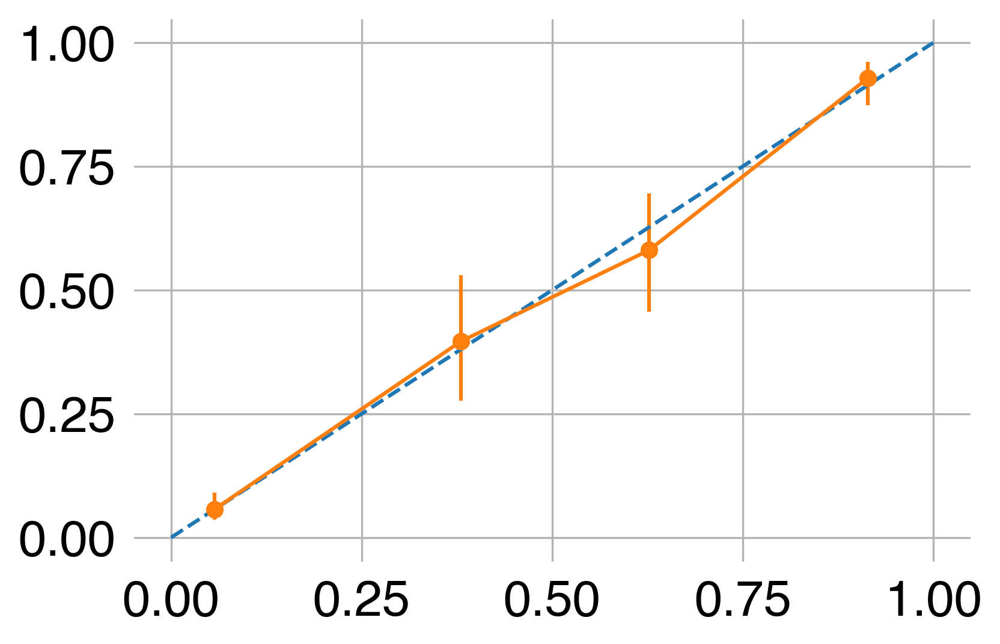

  category                 group      prop      mean        ll        ul  \
0        1  ballotpedia-campaign  0.044118  0.053692  0.020736  0.037588   
1        1                  orgs  0.092105  0.066091  0.046771  0.086022   
2        2  ballotpedia-campaign  0.333333  0.374578  0.131187  0.163327   
3        2                  orgs  0.529412  0.391651  0.219779  0.208937   
4        3  ballotpedia-campaign  0.567568  0.624052  0.158426  0.145715   
5        3                  orgs  0.600000  0.631602  0.192605  0.165967   
6        4  ballotpedia-campaign  0.925373  0.911335  0.088464  0.042331   
7        4                  orgs  0.931507  0.917060  0.082028  0.038884   

   count  
0  204.0  
1   76.0  
2   36.0  
3   17.0  
4   37.0  
5   25.0  
6   67.0  
7   73.0  
Brier score loss: 0.09247599537945532


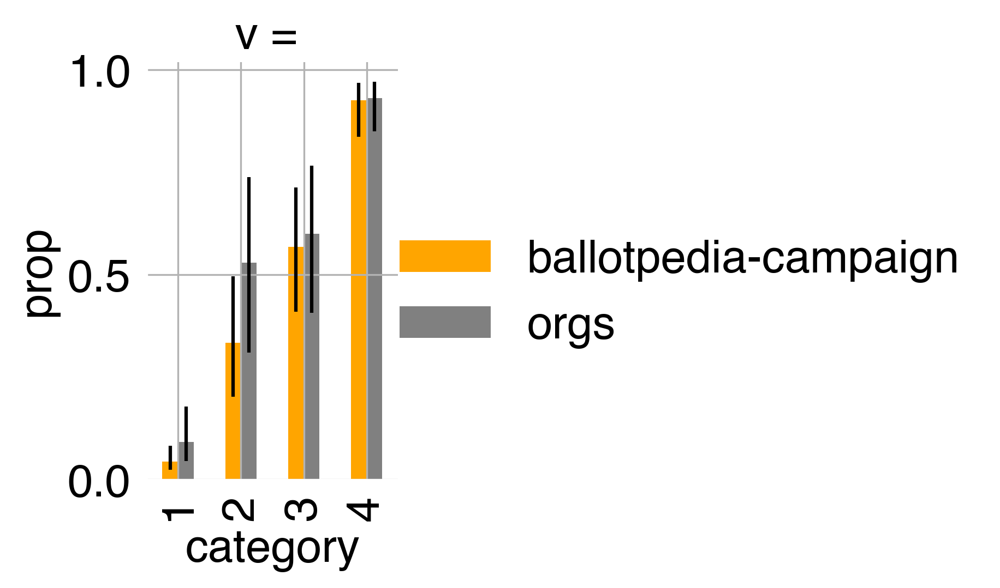

In [29]:
print_calibration_output(c, featVal, yVal, groups=xVal['source'], bins=4)

  category      prop      mean        ll        ul  count
0        1  0.047170  0.054414  0.021349  0.037468  212.0
1        2  0.351351  0.372515  0.133095  0.161058   37.0
2        3  0.560976  0.621701  0.150570  0.140123   41.0
3        4  0.933333  0.907720  0.080084  0.037857   75.0


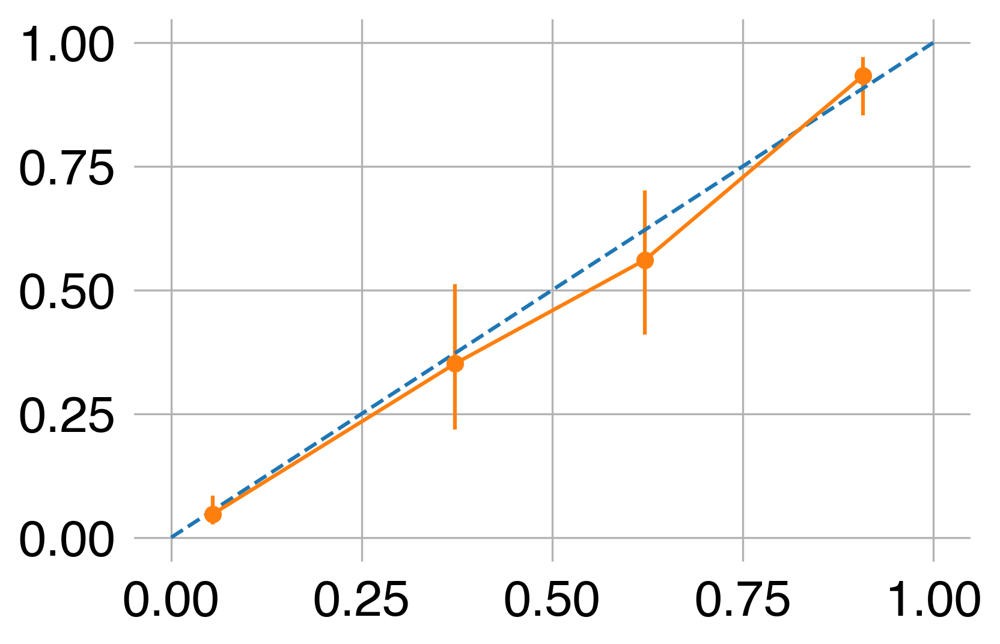

  category             group      prop      mean        ll            ul  \
0        1  Democratic Party  0.045977  0.051376  0.022498  4.211258e-02   
1        1  Republican Party  0.052632  0.068327  0.038077  1.202230e-01   
2        2  Democratic Party  0.266667  0.373091  0.124840  1.778130e-01   
3        2  Republican Party  0.714286  0.370043  0.355351  2.034954e-01   
4        3  Democratic Party  0.562500  0.617731  0.169244  1.558467e-01   
5        3  Republican Party  0.555556  0.635818  0.288904  2.556659e-01   
6        4  Democratic Party  0.924242  0.909631  0.089634  4.296554e-02   
7        4  Republican Party  1.000000  0.893707  0.299145 -1.110223e-16   

   count  
0  174.0  
1   38.0  
2   30.0  
3    7.0  
4   32.0  
5    9.0  
6   66.0  
7    9.0  
Brier score loss: 0.08387152652417226


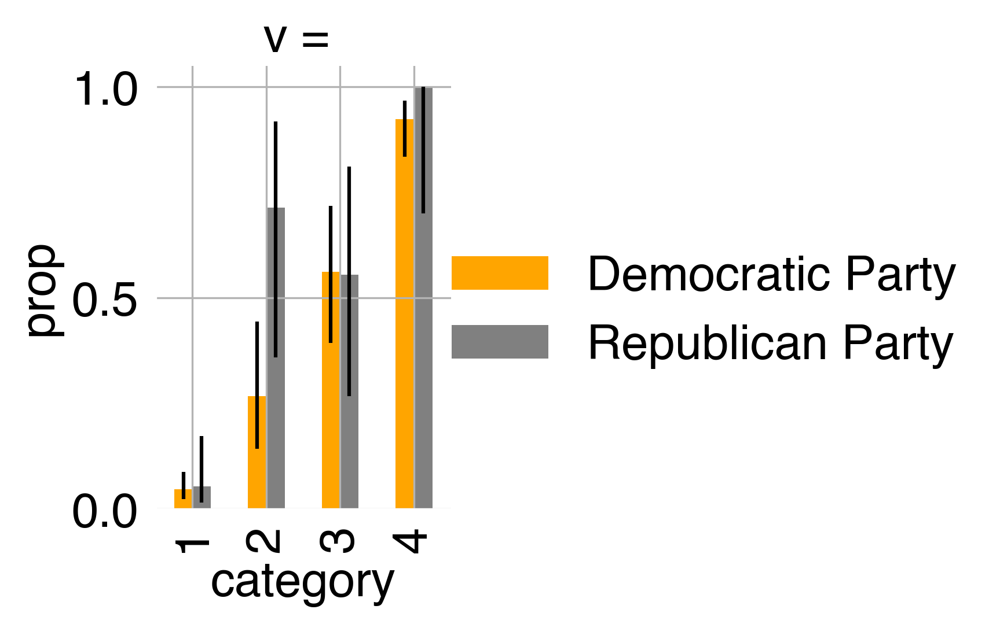

In [30]:
mask = (xVal['party_affiliation'] == 'Republican Party') | (xVal['party_affiliation'] == 'Democratic Party')

print_calibration_output(c, featVal[mask], yVal[mask], groups=xVal.loc[mask, 'party_affiliation'], bins=4)

  category      prop      mean        ll        ul  count
0        1  0.044118  0.053692  0.020736  0.037588  204.0
1        2  0.333333  0.374578  0.131187  0.163327   36.0
2        3  0.567568  0.624052  0.158426  0.145715   37.0
3        4  0.925373  0.911335  0.088464  0.042331   67.0


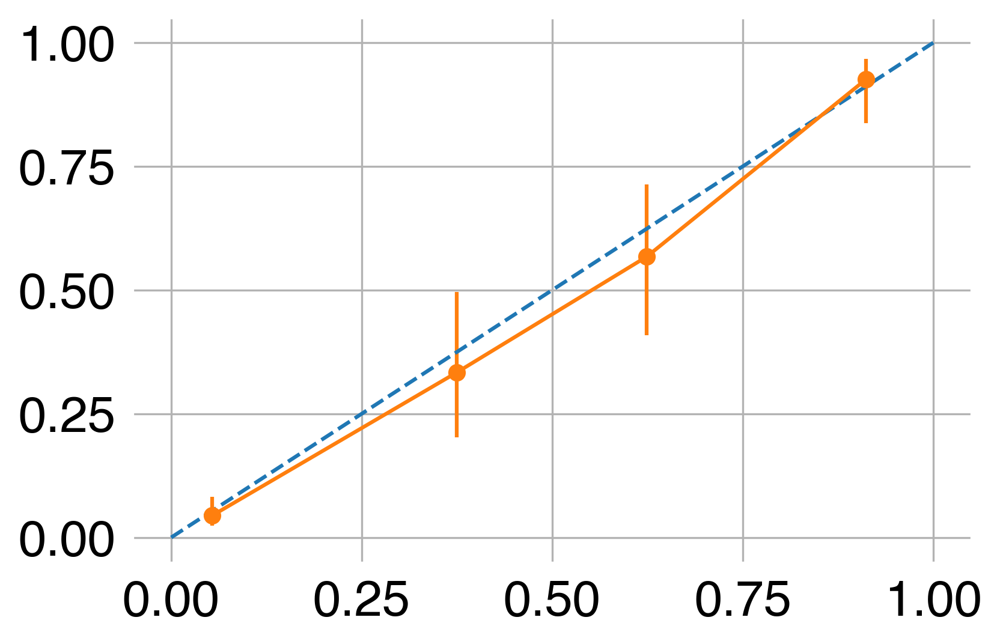

  category    group      prop      mean        ll        ul  count
0        1  Federal  0.048485  0.053967  0.023715  0.044261  165.0
1        1    State  0.025641  0.052529  0.021100  0.106169   39.0
2        2  Federal  0.366667  0.379509  0.147927  0.178198   30.0
3        2    State  0.166667  0.349921  0.136613  0.396836    6.0
4        3  Federal  0.612903  0.622401  0.174662  0.149766   31.0
5        3    State  0.333333  0.632582  0.236562  0.366673    6.0
6        4  Federal  0.912281  0.911159  0.101729  0.049668   57.0
7        4    State  1.000000  0.912339  0.277533  0.000000   10.0
Brier score loss: 0.08210794740832987


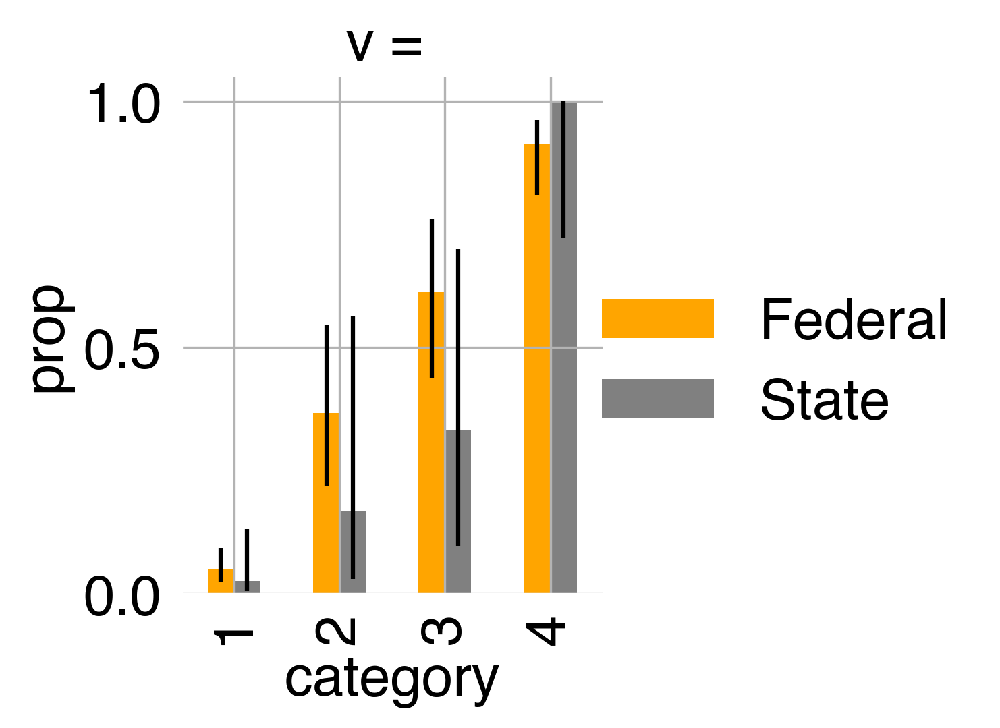

In [31]:
mask = (xVal['office_level'] == 'State') | (xVal['office_level'] == 'Federal')

print_calibration_output(c, featVal[mask], yVal[mask], groups=xVal.loc[mask, 'office_level'], bins=4)

  category      prop      mean        ll        ul  count
0        1  0.045226  0.054053  0.021253  0.038478  199.0
1        2  0.342857  0.377877  0.134540  0.165623   35.0
2        3  0.567568  0.624052  0.158426  0.145715   37.0
3        4  0.920635  0.914276  0.093338  0.044989   63.0


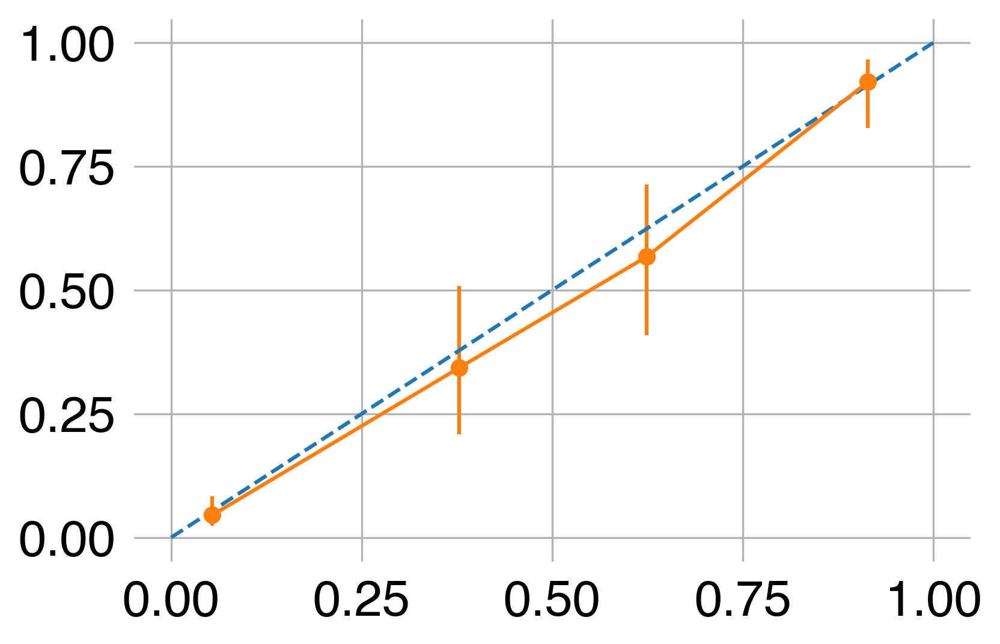

  category group      prop      mean        ll        ul  count
0        1    No  0.033784  0.050952  0.019269  0.042858  148.0
1        1   Yes  0.078431  0.063053  0.047509  0.106568   51.0
2        2    No  0.478261  0.380333  0.185889  0.192112   23.0
3        2   Yes  0.083333  0.373168  0.068468  0.270547   12.0
4        3    No  0.607143  0.637075  0.183052  0.157200   28.0
5        3   Yes  0.444444  0.583537  0.255666  0.288904    9.0
6        4    No  0.913043  0.912295  0.116290  0.052621   46.0
7        4   Yes  0.941176  0.919635  0.210997  0.048363   17.0
Brier score loss: 0.08400946124731018


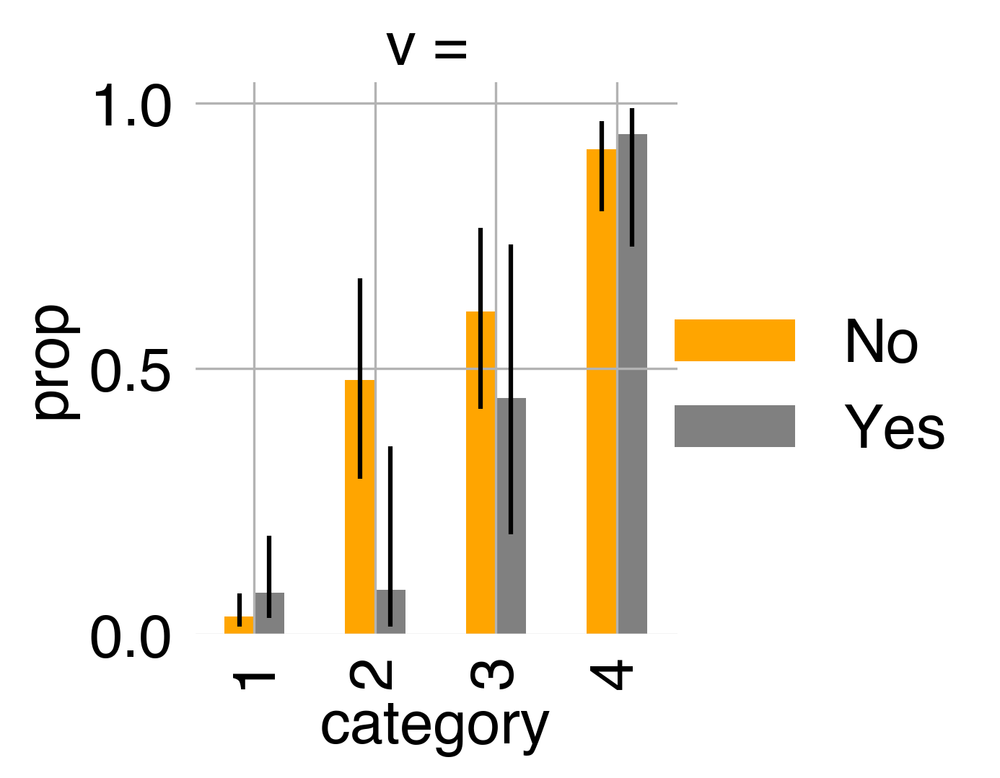

In [33]:
mask = (xVal['incumbent'] == 'Yes') | (xVal['incumbent'] == 'No')

print_calibration_output(c, featVal[mask], yVal[mask], groups=xVal.loc[mask, 'incumbent'], bins=4)

## Score entire dataset

All the emails.

In [34]:
emails = pd.read_pickle('../data/emails_df.pkl')

In [35]:
res = c.predict_proba(clf.named_steps['feature_pipeline'].transform(emails).todense())[:,1]


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.723 total time=   0.5s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.767 total time=   2.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipel


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.690 total time=   0.1s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.750 total time=   0.2s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=10, feature_


[CV 3/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.753 total time=   0.1s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.736 total time=   0.4s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipe


[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   1.6s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.806 total time=   0.3s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, featu


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.759 total time=   0.3s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.810 total time=   0.2s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, fe


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.696 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.788 total time=   0.7s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_p


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.782 total time=   2.8s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.786 total time=   0.2s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=100, feature_


[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.01, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.759 total time=   0.2s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=100, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.772 total time=   1.0s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur


[CV 5/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.776 total time=   0.1s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.743 total time=   0.9s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, feature_p


[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.718 total time=   0.2s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.760 total time=   0.1s
[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=10, f


[CV 4/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.765 total time=   0.7s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=0.1, feature_pipeline__select__k=500;, score=0.738 total time=   2.8s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline


[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=0.1, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.727 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.749 total time=   0.1s
[CV 2/5] END classifier__criterion=gini, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipelin


[CV 1/5] END classifier__criterion=entropy, classifier__max_depth=30, classifier__min_samples_leaf=2, classifier__min_samples_split=2, classifier__n_estimators=50, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.01, feature_pipeline__select__k=500;, score=0.736 total time=   0.3s
[CV 4/5] END classifier__criterion=entropy, classifier__max_depth=50, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.02, feature_pipeline__select__k=500;, score=0.776 total time=   2.6s
[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=5, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pi


[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=0.02, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.797 total time=   0.1s
[CV 3/5] END classifier__criterion=gini, classifier__max_depth=None, classifier__min_samples_leaf=10, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.005, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.773 total time=   0.6s
[CV 4/5] END classifier__criterion=gini, classifier__max_depth=50, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featur

In [36]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_' + label_column + '_score.pkl')

In [37]:
emails = None


[CV 5/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=10, feature_pipeline__features__dep_tags__features__max_df=1.0, feature_pipeline__features__ngram_tags__features__max_df=0.01, feature_pipeline__features__pos_tags__features__max_df=1.0, feature_pipeline__select__k=500;, score=0.734 total time=   0.1s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=2, classifier__min_samples_split=10, classifier__n_estimators=200, feature_pipeline__features__dep_tags__features__max_df=0.005, feature_pipeline__features__ngram_tags__features__max_df=0.02, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.828 total time=   0.7s
[CV 2/5] END classifier__criterion=entropy, classifier__max_depth=100, classifier__min_samples_leaf=10, classifier__min_samples_split=2, classifier__n_estimators=100, featu

All the A/B testing emails.

In [38]:
emails = pd.read_pickle('../data/emails_ab_df.pkl')

0;, score=0.754 total time=   0.3s
[CV 1/5] END classifier__criterion=gini, classifier__max_depth=30, classifier__min_samples_leaf=10, classifier__min_samples_split=5, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.04, feature_pipeline__features__ngram_tags__features__max_df=1.0, feature_pipeline__features__pos_tags__features__max_df=0.04, feature_pipeline__select__k=500;, score=0.723 total time=   1.6s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=5, classifier__min_samples_split=10, classifier__n_estimators=500, feature_pipeline__features__dep_tags__features__max_df=0.1, feature_pipeline__features__ngram_tags__features__max_df=0.04, feature_pipeline__features__pos_tags__features__max_df=0.005, feature_pipeline__select__k=500;, score=0.784 total time=   1.8s
[CV 3/5] END classifier__criterion=entropy, classifier__max_depth=10, classifier__min_samples_leaf=10, classifier__min_samples_split=2, c

In [39]:
res = c.predict_proba(clf.named_steps['feature_pipeline'].transform(emails).todense())[:,1]

In [40]:
pd.DataFrame({label_column + '_score': res}).to_pickle('../data/output/emails_ab_' + label_column + '_score.pkl')

In [41]:
emails = res = None